In [386]:
import numpy as np
import matplotlib.pyplot as plt
import numba
from numba import njit
from scipy.ndimage import convolve, generate_binary_structure


In [387]:
N = 100

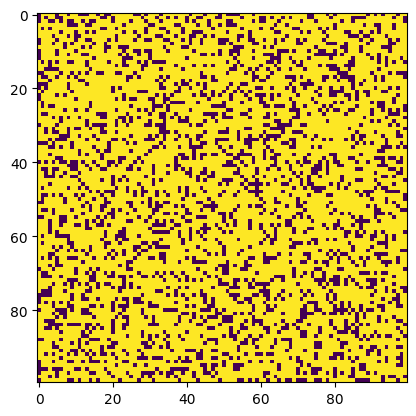

In [413]:
init_random = np.random.random((N,N))
lattice1 = np.zeros((N, N))
lattice1[init_random>=0.75] = -1
lattice1[init_random<0.75] = 1
plt.imshow(lattice1)

In [414]:
def get_energy(lattice): 
    kern = generate_binary_structure(2, 1) 
    kern[1][1] = False
    arr = -lattice * convolve(lattice, kern, mode='constant', cval=0)
    return arr.sum()

[[False  True False]
 [ True False  True]
 [False  True False]] 




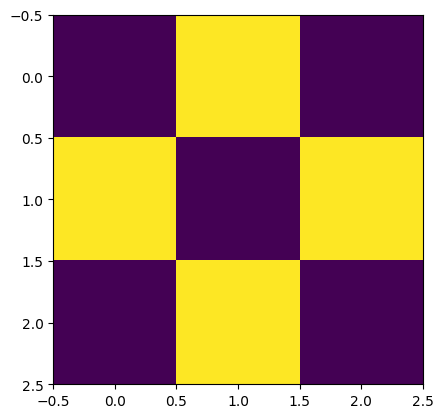

In [415]:
kern = generate_binary_structure(2, 1) 
kern[1][1] = False
plt.imshow(kern)
print(kern,"\n\n")

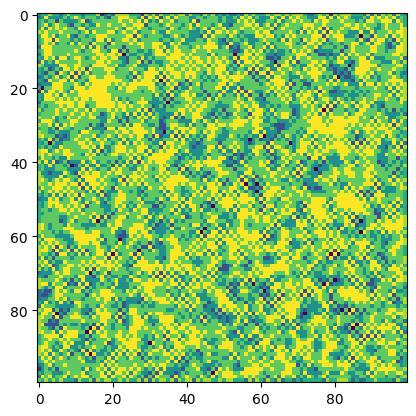

In [435]:
plt.imshow(convolve(lattice1, kern, mode='constant', cval=0))

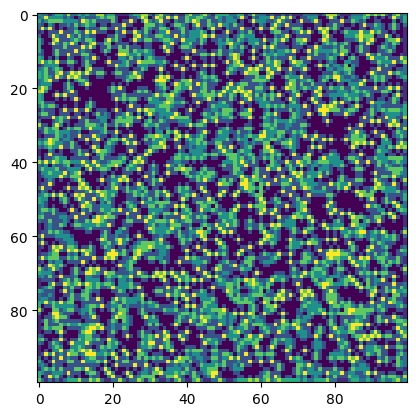

In [436]:
plt.imshow(-lattice1 * convolve(lattice1, kern, mode='constant', cval=0))

In [418]:
get_energy(lattice1)

-10144.0

In [419]:
@njit

# Define the metropolis function
def metropolis(spin_arr,times,BJ,energy):
    #N = spin_arr.shape[0]  # Assuming spin_arr is square
    spin_arr = spin_arr.copy()
    net_spins = np.zeros(times-1)
    net_energy = np.zeros(times-1)
    #system_array = np.zeros((N, N, times-1))
    
    for t in range(times-1):
        # Pick random point on array and flip spin
        x = np.random.randint(0, N)
        y = np.random.randint(0, N)
        spin_i = spin_arr[x, y]  # Initial spin
        spin_f = spin_i * -1  # Proposed spin flip
        
        # Compute change in energy
        E_i = 0
        E_f = 0
        if x > 0:
            E_i += -spin_i * spin_arr[x-1, y]
            E_f += -spin_f * spin_arr[x-1, y]
        if x < N - 1:
            E_i += -spin_i * spin_arr[x+1, y]
            E_f += -spin_f * spin_arr[x+1, y]
        if y > 0:
            E_i += -spin_i * spin_arr[x, y-1]
            E_f += -spin_f * spin_arr[x, y-1]
        if y < N - 1:
            E_i += -spin_i * spin_arr[x, y+1]
            E_f += -spin_f * spin_arr[x, y+1]
        
        # Change state with designated probabilities
        dE = E_f - E_i
        if (dE > 0) and (np.random.random() < np.exp(-BJ * dE)):
            spin_arr[x, y] = spin_f
            energy += dE
        elif dE <= 0:
            spin_arr[x, y] = spin_f
            energy += dE
            
        net_spins[t] = spin_arr.sum()
        net_energy[t] = energy
        
    return net_spins, net_energy
    


In [420]:
@njit
# Define the metropolis function (config included)
def metropolis_s(spin_arr,times,BJ,energy):
    #N = spin_arr.shape[0]  # Assuming spin_arr is square
    spin_arr = spin_arr.copy()
    net_spins = np.zeros(times-1)
    net_energy = np.zeros(times-1)
    system_array = np.zeros((N, N, times-1))
    
    for t in range(times-1):
        # Pick random point on array and flip spin
        x = np.random.randint(0, N)
        y = np.random.randint(0, N)
        spin_i = spin_arr[x, y]  # Initial spin
        spin_f = spin_i * -1  # Proposed spin flip
        
        # Compute change in energy
        E_i = 0
        E_f = 0
        if x > 0:
            E_i += -spin_i * spin_arr[x-1, y]
            E_f += -spin_f * spin_arr[x-1, y]
        if x < N - 1:
            E_i += -spin_i * spin_arr[x+1, y]
            E_f += -spin_f * spin_arr[x+1, y]
        if y > 0:
            E_i += -spin_i * spin_arr[x, y-1]
            E_f += -spin_f * spin_arr[x, y-1]
        if y < N - 1:
            E_i += -spin_i * spin_arr[x, y+1]
            E_f += -spin_f * spin_arr[x, y+1]
        
        # Change state with designated probabilities
        dE = E_f - E_i
        if (dE > 0) and (np.random.random() < np.exp(-BJ * dE)):
            spin_arr[x, y] = spin_f
            energy += dE
        elif dE <= 0:
            spin_arr[x, y] = spin_f
            energy += dE
            
        net_spins[t] = spin_arr.sum()
        net_energy[t] = energy
        system_array[:,:,t] = spin_arr  # assign the entire spin_arr to the t-th layer
    return net_spins, net_energy, system_array


In [421]:
spins, energies,config=metropolis_s(lattice1, 10, 0.2, get_energy(lattice1))


In [422]:
config.shape

(100, 100, 9)

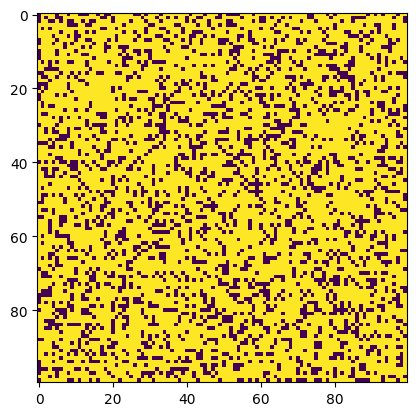

In [423]:
plt.imshow(config[:,:,4])

In [424]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
t=1000
spins, energies,a = metropolis_s(lattice1, t, 0.2, get_energy(lattice1))

# Set up the figure and axis for animation
fig, ax = plt.subplots()
img = ax.imshow(a[:, :, 0])

# Animation update function
def update(frame):
    img.set_array(a[:, :, frame-1])  # Update the image with the current frame
    return img,

# Create the animation
ani = FuncAnimation(fig, update, frames=t, interval=1, blit=True)
ani.save('D:/PPT/animation.gif', writer='imagemagick', fps=30)  # Save as GIF
# Display the animation in Jupyter Notebook
plt.close(fig)  # Prevents the static display of the last frame
HTML(ani.to_jshtml())  # Use to_jshtml() for better compatibility in Jupyter


MovieWriter imagemagick unavailable; using Pillow instead.


In [425]:
spins, energies = metropolis(lattice1, 1000000, 0.7, get_energy(lattice1))

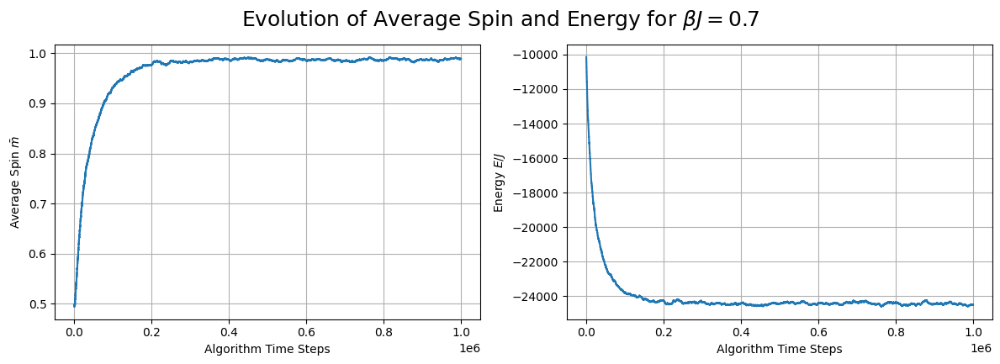

In [426]:
fig, axes = plt.subplots(1, 2, figsize=(12,4))
ax = axes[0]
ax.plot(spins/N**2)
ax.set_xlabel('Algorithm Time Steps')
ax.set_ylabel(r'Average Spin $\bar{m}$')
ax.grid()
ax = axes[1]
ax.plot(energies)
ax.set_xlabel('Algorithm Time Steps')
ax.set_ylabel(r'Energy $E/J$')
ax.grid()
fig.tight_layout()
fig.suptitle(r'Evolution of Average Spin and Energy for $\beta J=$0.7', y=1.07, size=18)
plt.show()

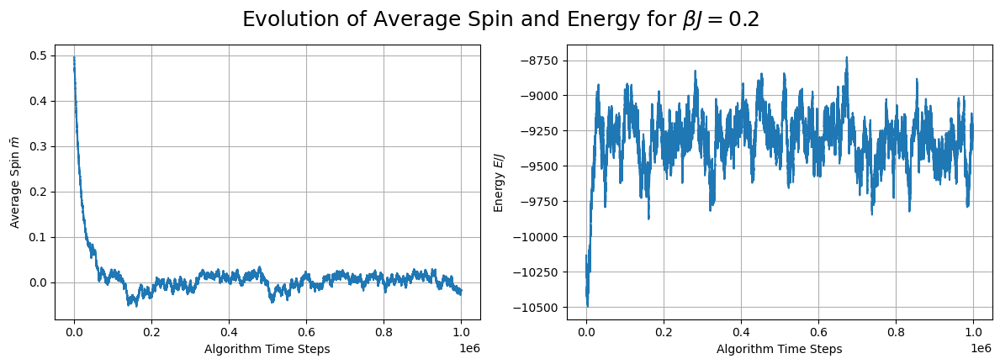

In [428]:
spins, energies = metropolis(lattice1, 1000000, 0.2, get_energy(lattice1))

fig, axes = plt.subplots(1, 2, figsize=(12,4))
ax = axes[0]
ax.plot(spins/N**2)
ax.set_xlabel('Algorithm Time Steps')
ax.set_ylabel(r'Average Spin $\bar{m}$')
ax.grid()
ax = axes[1]
ax.plot(energies)
ax.set_xlabel('Algorithm Time Steps')
ax.set_ylabel(r'Energy $E/J$')
ax.grid()
fig.tight_layout()
fig.suptitle(r'Evolution of Average Spin and Energy for $\beta J=$0.2', y=1.07, size=18)
plt.show()

In [429]:
def get_spin_energy(lattice, BJs):
    ms = np.zeros(len(BJs))
    E_means = np.zeros(len(BJs))
    E_stds = np.zeros(len(BJs))
    for i, bj in enumerate(BJs):
        spins, energies = metropolis(lattice, 1000000, bj, get_energy(lattice))
        ms[i] = spins[-100000:].mean()/N**2
        E_means[i] = energies[-100000:].mean()
        E_stds[i] = energies[-100000:].std()
    return ms, E_means, E_stds
    
BJs = np.arange(0.1, 2, 0.05)
ms, E_means, E_stds = get_spin_energy(lattice1, BJs)


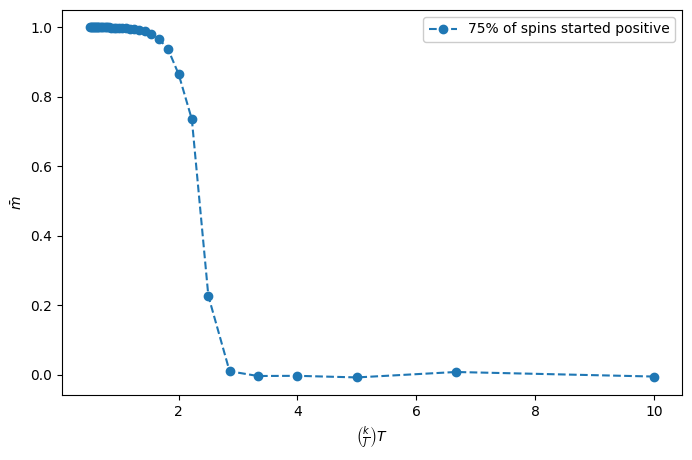

In [433]:
plt.figure(figsize=(8,5))
plt.plot(1/BJs, ms, 'o--', label='75% of spins started positive')
plt.xlabel(r'$\left(\frac{k}{J}\right)T$')
plt.ylabel(r'$\bar{m}$')
plt.legend(facecolor='white', framealpha=1)
plt.show()

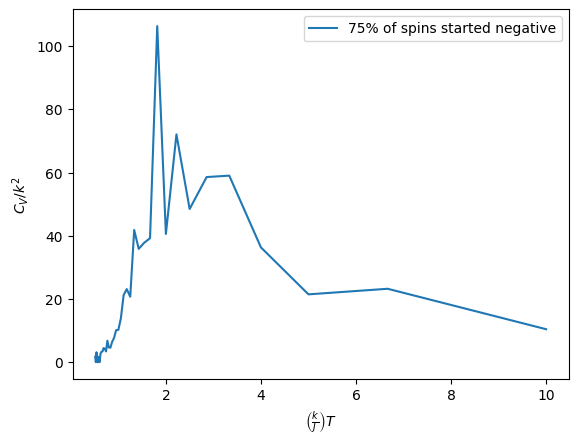

In [431]:
plt.plot(1/BJs, E_stds*BJs, label='75% of spins started positive')
plt.xlabel(r'$\left(\frac{k}{J}\right)T$')
plt.ylabel(r'$C_V / k^2$')
plt.legend()
plt.show()